# Let's Clean the Feature Data

Let's make sure our features are clean. This feature engineering might help the model more accurately predict civil unrest if there's less garbage. 

---

Let's load the feature data

---

In [2]:
import pandas as pd

# Load the feature data
data = pd.read_csv('features_data.csv')
data

,SQLDATE,EventCode,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,AvgTone
0,20241211,145,"Chicago, Illinois, United States",41.8500,-87.6501,-4.147465
1,20241211,145,"Chicago, Illinois, United States",41.8500,-87.6501,-4.147465
2,20241206,145,"Chicago, Illinois, United States",41.8500,-87.6501,1.066667
3,20241202,145,"Chicago, Illinois, United States",41.8500,-87.6501,-7.840083
4,20241202,145,"University Of Chicago, Illinois, United States",41.7898,-87.5998,-0.843289
...,...,...,...,...,...,...
3344,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.494577
3345,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.494577
3346,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.494577
3347,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.857143


---

Later I'll realize that I'd like to know exactly what time of day the events occur at. This would require upgrading to `GDELT 2.0`. This is something I'll leave to further improvements to my model. I may conduct this in the future.

---

In [54]:
data

,SQLDATE,EventCode,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,AvgTone
0,20241211,145,"Chicago, Illinois, United States",41.8500,-87.6501,-4.147465
1,20241211,145,"Chicago, Illinois, United States",41.8500,-87.6501,-4.147465
2,20241206,145,"Chicago, Illinois, United States",41.8500,-87.6501,1.066667
3,20241202,145,"Chicago, Illinois, United States",41.8500,-87.6501,-7.840083
4,20241202,145,"University Of Chicago, Illinois, United States",41.7898,-87.5998,-0.843289
...,...,...,...,...,...,...
3344,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.494577
3345,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.494577
3346,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.494577
3347,20150119,145,"Chicago, Illinois, United States",41.8500,-87.6501,2.857143


---

Ok now let's plot it in the region we pulled the data from to ensure it's the correct data.

---

In [65]:
# Define a colormap
colormap = plt.cm.get_cmap('Reds')

# Normalize the AvgTone values to the range [0, 1] and invert the colormap
norm = colors.Normalize(vmin=-data['AvgTone'].max(), vmax=-data['AvgTone'].min())

# Create a map centered around the average latitude and longitude
m = folium.Map(location=[data['ActionGeo_Lat'].mean(), data['ActionGeo_Long'].mean()], zoom_start=4)

# Add markers for each event in the data DataFrame
for index, row in data.iterrows():
    # Get the color based on the normalized AvgTone value
    color = colors.rgb2hex(colormap(norm(-row['AvgTone'])))
    folium.Circle(
        location=[row['ActionGeo_Lat'], row['ActionGeo_Long']],
        radius=100,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=f"Date: {row['SQLDATE']}, EventCode: {row['EventCode']}, AvgTone: {row['AvgTone']}"
    ).add_to(m)

# Get the minimum and maximum latitude and longitude
min_lat = data['ActionGeo_Lat'].min()
max_lat = data['ActionGeo_Lat'].max()
min_long = data['ActionGeo_Long'].min()
max_long = data['ActionGeo_Long'].max()

# Add a blue rectangle to the map
folium.Rectangle(
    bounds=[[min_lat, min_long], [max_lat, max_long]],
    color='blue',
    fill=False
).add_to(m)

# Display the updated map
m

/var/folders/bh/bs5kljm140s_4k8bp_hzf8n00000gn/T/ipykernel_20097/2386164804.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = plt.cm.get_cmap('Reds')


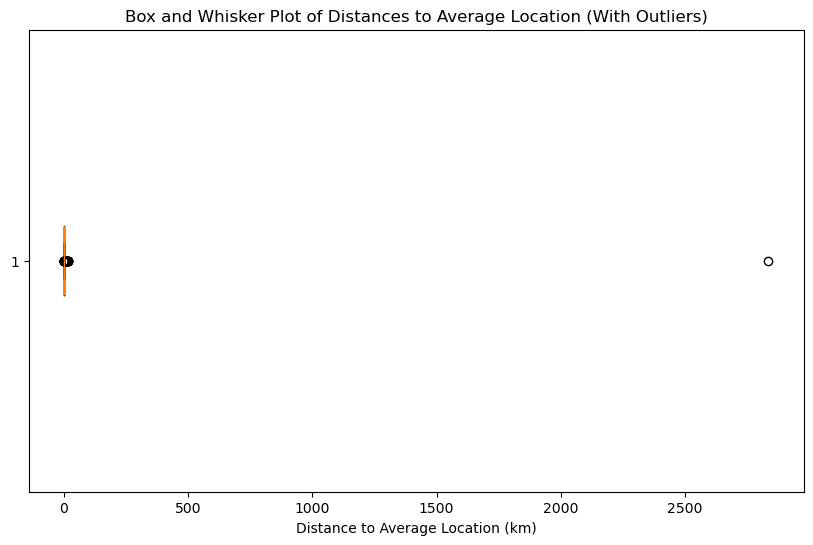

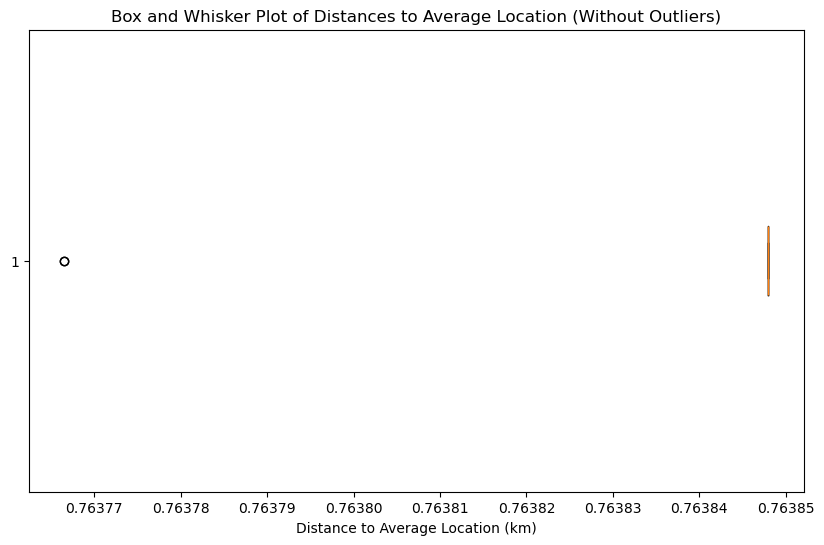

In [56]:
# Calculate the average latitude and longitude
avg_lat = data['ActionGeo_Lat'].mean()
avg_long = data['ActionGeo_Long'].mean()

# Calculate the distance of each event to the average point
data['Distance_to_Avg'] = data.apply(lambda row: geodesic((row['ActionGeo_Lat'], row['ActionGeo_Long']), (avg_lat, avg_long)).kilometers, axis=1)

# Create a copy of the data to avoid mutating the original
data_copy = data.copy()

# Identify the outlier using the IQR method
Q1 = data_copy['Distance_to_Avg'].quantile(0.25)
Q3 = data_copy['Distance_to_Avg'].quantile(0.75)
IQR = Q3 - Q1
outlier_condition = data_copy['Distance_to_Avg'] > (Q3 + 1.5 * IQR)

# Remove the outlier from the data copy
cleaned_data = data_copy[~outlier_condition]

# Plot a box and whisker plot for the distances with the outlier
plt.figure(figsize=(10, 6))
plt.boxplot(data['Distance_to_Avg'], vert=False)
plt.xlabel('Distance to Average Location (km)')
plt.title('Box and Whisker Plot of Distances to Average Location (With Outliers)')
plt.show()

# Plot a box and whisker plot for the distances without the outlier
plt.figure(figsize=(10, 6))
plt.boxplot(cleaned_data['Distance_to_Avg'], vert=False)
plt.xlabel('Distance to Average Location (km)')
plt.title('Box and Whisker Plot of Distances to Average Location (Without Outliers)')
plt.show()

In [57]:
# Number of rows in cleaned_data
num_rows_cleaned_data = len(cleaned_data)
print(f"Number of rows in cleaned_data: {num_rows_cleaned_data}")

# Number of rows in data
num_rows_data = len(data)
print(f"Number of rows in data: {num_rows_data}")

# Removed rows from data
removed_rows = data[outlier_condition]
print("Removed rows from data:")

# Check that removed_rows has the same length as the difference between the two data sources
if len(removed_rows) == (num_rows_data - num_rows_cleaned_data):
    print(f"The number of removed rows matches the difference between the original and cleaned data. {len(removed_rows)} rows were removed.")
else:
    print("The number of removed rows does not match the difference between the original and cleaned data.")

removed_rows


Number of rows in cleaned_data: 3234
Number of rows in data: 3349
Removed rows from data:
The number of removed rows matches the difference between the original and cleaned data. 115 rows were removed.


,SQLDATE,EventCode,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,AvgTone,Distance_to_Avg
4,20241202,145,"University Of Chicago, Illinois, United States",41.7898,-87.5998,-0.843289,8.226683
5,20241202,145,"University Of Chicago, Illinois, United States",41.7898,-87.5998,-0.843289,8.226683
255,20240529,145,"Art Institute Of Chicago, Illinois, United States",41.8795,-87.6223,-1.477105,4.563697
341,20240220,145,"Art Institute Of Chicago, Illinois, United States",41.8795,-87.6223,-0.286670,4.563697
372,20230915,145,"Art Institute Of Chicago, Illinois, United States",41.8795,-87.6223,-1.963534,4.563697
...,...,...,...,...,...,...,...
3161,20160320,145,"University Of Illinois At Chicago, Illinois, U...",41.8720,-87.6492,-7.417219,2.680776
3188,20160313,145,"University Of Illinois At Chicago, Illinois, U...",41.8720,-87.6492,-8.571429,2.680776
3194,20160313,145,"University Of Illinois At Chicago, Illinois, U...",41.8720,-87.6492,-8.571429,2.680776
3202,20160312,145,"Chicago Loop, Illinois, United States",41.8811,-87.6298,-2.366864,4.316466


In [58]:
# Create a map centered around the average latitude and longitude of the removed rows
m_removed = folium.Map(location=[removed_rows['ActionGeo_Lat'].mean(), removed_rows['ActionGeo_Long'].mean()], zoom_start=10)

# Add markers for each event in the removed_rows DataFrame
for index, row in removed_rows.iterrows():
    # Get the color based on the normalized AvgTone value
    color = colors.rgb2hex(colormap(norm(-row['AvgTone'])))
    folium.Circle(
        location=[row['ActionGeo_Lat'], row['ActionGeo_Long']],
        radius=100,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=f"Date: {row['SQLDATE']}, EventCode: {row['EventCode']}, AvgTone: {row['AvgTone']}"
    ).add_to(m_removed)

# Display the map with removed rows
m_removed

In [59]:
cleaned_data

,SQLDATE,EventCode,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,AvgTone,Distance_to_Avg
0,20241211,145,"Chicago, Illinois, United States",41.85,-87.6501,-4.147465,0.763848
1,20241211,145,"Chicago, Illinois, United States",41.85,-87.6501,-4.147465,0.763848
2,20241206,145,"Chicago, Illinois, United States",41.85,-87.6501,1.066667,0.763848
3,20241202,145,"Chicago, Illinois, United States",41.85,-87.6501,-7.840083,0.763848
6,20241118,145,"Chicago, Illinois, United States",41.85,-87.6501,-6.067678,0.763848
...,...,...,...,...,...,...,...
3344,20150119,145,"Chicago, Illinois, United States",41.85,-87.6501,2.494577,0.763848
3345,20150119,145,"Chicago, Illinois, United States",41.85,-87.6501,2.494577,0.763848
3346,20150119,145,"Chicago, Illinois, United States",41.85,-87.6501,2.494577,0.763848
3347,20150119,145,"Chicago, Illinois, United States",41.85,-87.6501,2.857143,0.763848


In [60]:
# Create a map centered around the average latitude and longitude
m = folium.Map(location=[cleaned_data['ActionGeo_Lat'].mean(), cleaned_data['ActionGeo_Long'].mean()], zoom_start=10)

# Add markers for each event in the data DataFrame
for index, row in cleaned_data.iterrows():
    # Get the color based on the normalized AvgTone value
    color = colors.rgb2hex(colormap(norm(-row['AvgTone'])))
    folium.Circle(
        location=[row['ActionGeo_Lat'], row['ActionGeo_Long']],
        radius=100,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=f"Date: {row['SQLDATE']}, EventCode: {row['EventCode']}, AvgTone: {row['AvgTone']}"
    ).add_to(m)

# Get the minimum and maximum latitude and longitude
min_lat = cleaned_data['ActionGeo_Lat'].min()
max_lat = cleaned_data['ActionGeo_Lat'].max()
min_long = cleaned_data['ActionGeo_Long'].min()
max_long = cleaned_data['ActionGeo_Long'].max()

# Add a blue rectangle to the map
folium.Rectangle(
    bounds=[[min_lat, min_long], [max_lat, max_long]],
    color='blue',
    fill=False
).add_to(m)

# Display the updated map
m

---

Let's try to understand how bad an event was. The column, "AvgTone" might be insightful.

Here's the documentation
> ### AvgTone. 
> (numeric) This is the average “tone” of all documents containing one or more
> mentions of this event. The score ranges from -100 (extremely negative) to +100 (extremely
> positive). Common values range between -10 and +10, with 0 indicating neutral. This can be
> used as a method of filtering the “context” of events as a subtle measure of the importance of
> an event and as a proxy for the “impact” of that event. For example, a riot event with a slightly
> negative average tone is likely to have been a minor occurrence, whereas if it had an extremely
> negative average tone, it suggests a far more serious occurrence. A riot with a positive score
> likely suggests a very minor occurrence described in the context of a more positive narrative
> (such as a report of an attack occurring in a discussion of improving conditions on the ground in
> a country and how the number of attacks per day has been greatly reduced).
[![GDELT Data Format Codebook](https://img.shields.io/badge/GDELT%20Data%20Format%20Codebook-Download-blue)](http://data.gdeltproject.org/documentation/GDELT-Data_Format_Codebook.pdf)

Here it's clear that an event with a very negative value would be considered more **impactful**. I'm going to assume this is a proxy for more dangerious. The example mentioned supports this claim. Thus, the lower the "AvgTone," the worse the event was.

Let's first plot the events and scale the colors so that the worse the event, the lower the "AvgTone," the **darker the red**.


---


---

#### Error
Notice that I ensured that the darker color was associated with a more negative event, as would be intuiative.

That's why the following line is "flipped"

`norm = colors.Normalize(vmin=-data['AvgTone'].max(), vmax=-data['AvgTone'].min())`



---

In [61]:
# Define a colormap
colormap = plt.cm.get_cmap('Reds')

# Normalize the AvgTone values to the range [0, 1] and invert the colormap
norm = colors.Normalize(vmin=-data['AvgTone'].max(), vmax=-data['AvgTone'].min())

# Add markers for each event in the data DataFrame
for index, row in data.iterrows():
    # Get the color based on the normalized AvgTone value
    color = colors.rgb2hex(colormap(norm(-row['AvgTone'])))
    folium.Circle(
        location=[row['ActionGeo_Lat'], row['ActionGeo_Long']],
        radius=100,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=f"Date: {row['SQLDATE']}, EventCode: {row['EventCode']}, AvgTone: {row['AvgTone']}"
    ).add_to(m)

# Display the updated map
m

/var/folders/bh/bs5kljm140s_4k8bp_hzf8n00000gn/T/ipykernel_20097/3526197807.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = plt.cm.get_cmap('Reds')


---

We can now see that the data we pulled is relevant to my path to school. We can also see the colors associated with how concerning the event was.

---

---

Save the data to .csv

---

In [62]:
data.to_csv('data.csv', index=False)